<a href="https://colab.research.google.com/github/Shumaque/project/blob/main/6232.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement
### In this case study, we examine the Housing Prices in California to figure out what factors influence prices the most. The inteligence will be relevant for the companies to determine the income of the household, which can then be utilized to incorporate targeted ads.


In [46]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from plotly import express as px

In [45]:
data = pd.read_csv("/content/data/CaliDataset.csv")
data

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


# Data Exploration

In [10]:
#list down the columns
data.keys()

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity'],
      dtype='object')

*   Let's check the random ten number of data samples, so we can easly understand the behaviour and what types of data type stored in particular features.




In [ ]:
#list down random samples of data
data.sample(10)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
13014,-121.17,38.69,5.0,7138.0,1227.0,2623.0,1139.0,5.6902,243200.0,INLAND
5906,-118.43,34.30,28.0,271.0,61.0,246.0,62.0,1.7062,164600.0,<1H OCEAN
4327,-118.33,34.08,52.0,1777.0,454.0,671.0,439.0,3.5083,500001.0,<1H OCEAN
17259,-119.72,34.42,31.0,1524.0,383.0,1257.0,398.0,2.6019,250000.0,NEAR OCEAN
8208,-118.17,33.79,32.0,2171.0,672.0,3002.0,648.0,2.3750,139700.0,NEAR OCEAN
16599,-120.70,35.76,15.0,1914.0,425.0,1130.0,421.0,2.2165,90600.0,<1H OCEAN
19045,-121.82,38.46,10.0,6331.0,1181.0,3419.0,1110.0,3.7083,154800.0,INLAND
2442,-119.61,36.57,42.0,2242.0,521.0,1359.0,483.0,1.5833,65100.0,INLAND
11741,-121.13,38.87,48.0,1127.0,NaN,530.0,186.0,3.0917,128100.0,INLAND
6258,-117.96,34.05,36.0,1475.0,270.0,1149.0,284.0,3.0904,158600.0,<1H OCEAN


*   Target Feature

In [ ]:

TARGET_FEATURE = 'median_house_value'

Y = data[TARGET_FEATURE]

Y.head(10)

0    452600.0
1    358500.0
2    352100.0
3    341300.0
4    342200.0
5    269700.0
6    299200.0
7    241400.0
8    226700.0
9    261100.0
Name: median_house_value, dtype: float64

In [12]:

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [13]:

data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [14]:
numeric_features = data.select_dtypes(['int', 'float']).columns
numeric_features , len(numeric_features)

(Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
        'total_bedrooms', 'population', 'households', 'median_income',
        'median_house_value'],
       dtype='object'),
 9)

In [15]:
categorical_features = data.select_dtypes('object').columns
categorical_features, len(categorical_features)

(Index(['ocean_proximity'], dtype='object'), 1)

In [16]:
print("Number of 'Numerical' Features are:", len(numeric_features) )
print("Number of 'Categorical' Features are:", len(categorical_features) )

Number of 'Numerical' Features are: 9
Number of 'Categorical' Features are: 1


# Data Pre-Processing

Text(0, 0.5, 'Count')

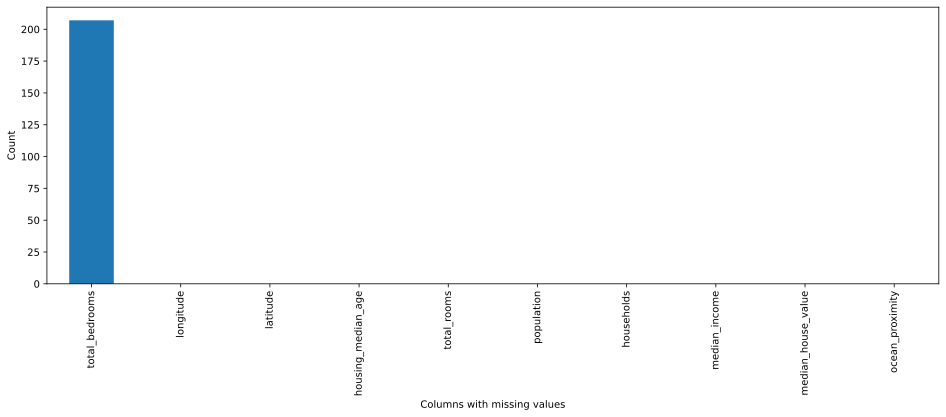

In [17]:
missing = data.isna().sum().sort_values(ascending=False)
missing.plot.bar(figsize=(16,5))
plt.xlabel('Columns with missing values')
plt.ylabel('Count')

In [18]:
missing

total_bedrooms        207
longitude               0
latitude                0
housing_median_age      0
total_rooms             0
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [19]:
data[['total_bedrooms']].describe(include='all')

,total_bedrooms
count,20433.000000
mean,537.870553
std,421.385070
min,1.000000
25%,296.000000
50%,435.000000
75%,647.000000
max,6445.000000


In [20]:
data['total_bedrooms'] = data['total_bedrooms'].fillna(data['total_bedrooms'].mode()[0])
data.isna().any()

longitude             False
latitude              False
housing_median_age    False
total_rooms           False
total_bedrooms        False
population            False
households            False
median_income         False
median_house_value    False
ocean_proximity       False
dtype: bool

In [22]:
data[categorical_features].value_counts()

ocean_proximity
<1H OCEAN          9136
INLAND             6551
NEAR OCEAN         2658
NEAR BAY           2290
ISLAND                5
dtype: int64

In [25]:
data.head(10)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,3
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,3
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,3
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,3
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,3
5,-122.25,37.85,52.0,919.0,213.0,413.0,193.0,4.0368,269700.0,3
6,-122.25,37.84,52.0,2535.0,489.0,1094.0,514.0,3.6591,299200.0,3
7,-122.25,37.84,52.0,3104.0,687.0,1157.0,647.0,3.1200,241400.0,3
8,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,3
9,-122.25,37.84,52.0,3549.0,707.0,1551.0,714.0,3.6912,261100.0,3


In [27]:
Y = data['median_house_value']
Y

0        452600.0
1        358500.0
2        352100.0
3        341300.0
4        342200.0
           ...   
20635     78100.0
20636     77100.0
20637     92300.0
20638     84700.0
20639     89400.0
Name: median_house_value, Length: 20640, dtype: float64

In [29]:
models_summary = pd.DataFrame([],
                              columns=['Model_name',
                                       'Prediction_Score',
                                       'Mean_Absolute_error'
                                      ])
models_summary

,Model_name,Prediction_Score,Mean_Absolute_error


# Data Visualisation

In [39]:
import plotly.express as ex
ex.pie(data,names='ocean_proximity',title='Proportion of Locations of the house w.r.t ocean/sea')

We can see here that majority of the houses are close to the sea.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fa4179d4990>,
      dtype=object)

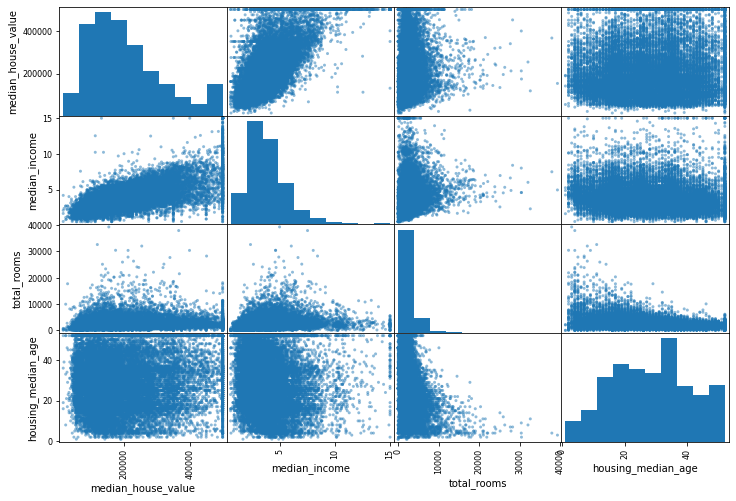

In [ ]:
from pandas.plotting import scatter_matrix
sct_features = ["median_house_value", "median_income","total_rooms","housing_median_age"]
scatter_matrix(data[sct_features],figsize=(12,8))

This visualization gives us an idea about the relation of median_house_value with other attributes.

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objs as go
fig = make_subplots(1,2)
fig.add_trace(go.Histogram(x=data['median_house_value']),1,1)
fig.add_trace(go.Box(y=data['median_house_value'],boxpoints='all',line_color='orange'),1,2)
fig.update_layout(height=500, showlegend=False,title_text="Median income distribution and Box Plot")

* The correlation matrix shows the relation between median_housing_value and Other Variables.

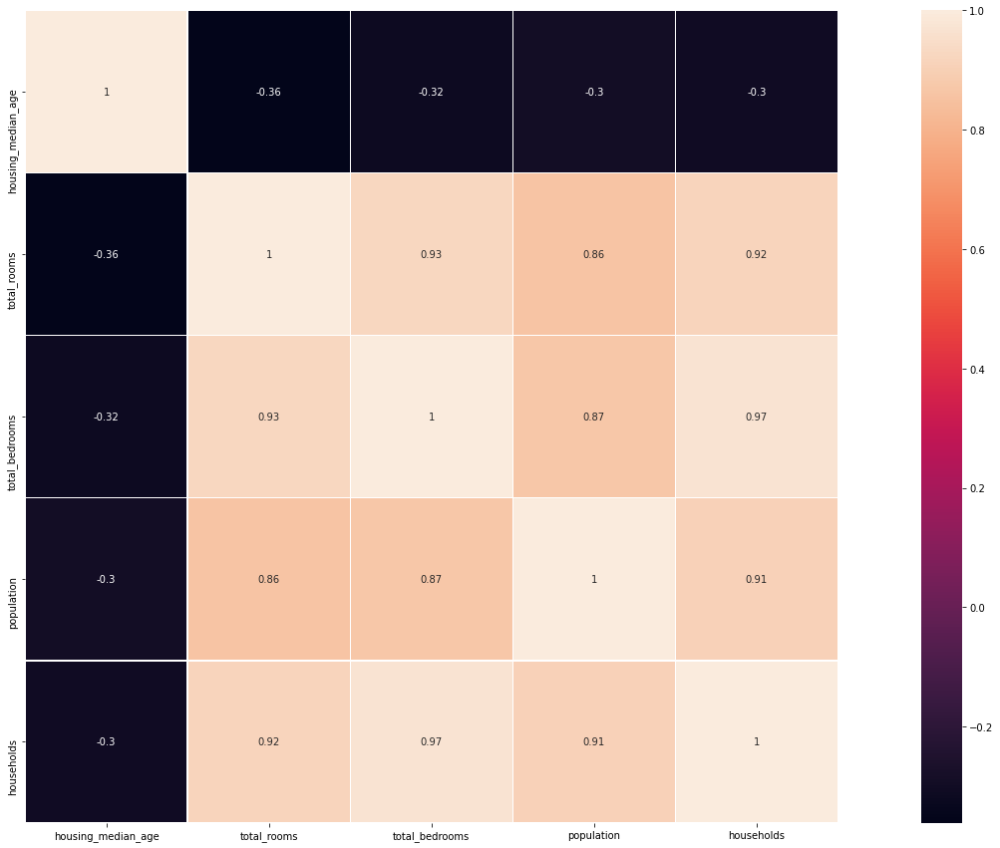

In [ ]:
corr_mat = data[['housing_median_age','total_rooms','total_bedrooms','population','households']].corr()
f, ax = plt.subplots(figsize=(30, 15))
sns.heatmap(corr_mat, vmax=1 , square=True,annot=True,linewidths=.5);

In [41]:
import matplotlib.image as mpimg

california_img=mpimg.imread('/content/data/california.png')

housing_plot = data[['longitude','population','latitude','median_house_value']]
housing_plot.plot(kind='scatter', x='longitude', y='latitude', alpha=0.4,
				s=housing_plot['population']/100, label='population', figsize=(10,7),
				c='median_house_value', cmap=plt.get_cmap('jet'), colorbar=True)


plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5)
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend()
plt.show()

In [42]:
data.plot(kind="scatter", x="longitude", y = "latitude", alpha=.05)

<Axes: xlabel='longitude', ylabel='latitude'>

# Conclusion

The analysis gives us a detailed visualisation of the Median Housing Prices in California. We noticed that the major cities in California have a huge difference in median house price with respect to the inland counties. Most of the high price properties are located in promixity to the ocean. The age of the houses are also striking, which the analysis concludes that the median age hovers around 30-40 years.

This detailed analysis will help advertisers to deliver targeted ads.